In [1]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import cv2

from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

In [2]:
#open the model
model = tf.keras.models.load_model('U-Net_2024-06-28.keras')

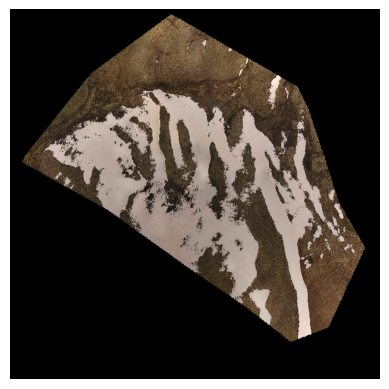

In [3]:
#load in 640_squared csv as dataframe
df = pd.read_csv('data/640_Squared/640_squared.csv')

#lets open up the first image
img = cv2.imread(df['snow_path'][1])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis('off')
plt.show()


In [4]:
#run image thorugh model
#add dimension
img = np.expand_dims(img, axis=0)

#predict
pred = model.predict(img)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 878ms/step


In [5]:
pred_reshape = pred[0]
pred_reshape.shape

(640, 640, 1)

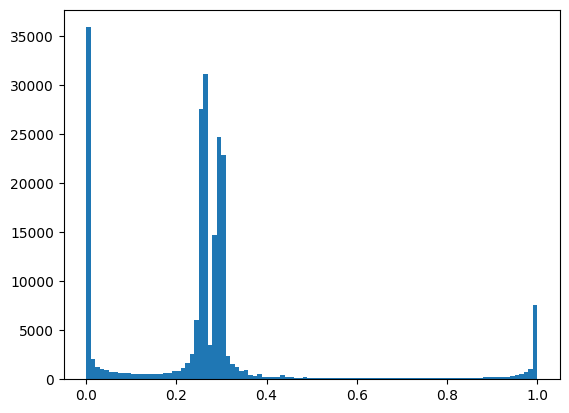

In [6]:
#get unique values from pred_reshape
unique, counts = np.unique(pred_reshape, return_counts=True)

#plot histogram of unique values
plt.hist(unique, bins=100)
plt.show()

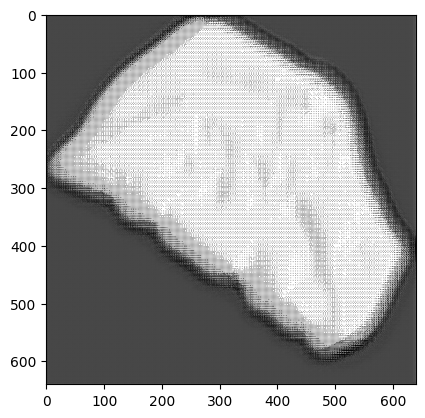

In [7]:
#display pred_resahpe
plt.imshow(pred_reshape, cmap='gray')

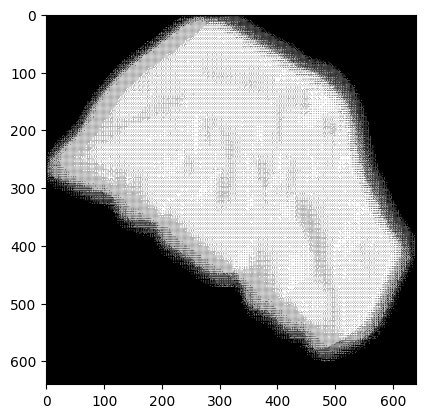

In [8]:
#round all values to 0 or 1
pred_round = np.round(pred_reshape)

#display pred_round
plt.imshow(pred_round, cmap='gray')

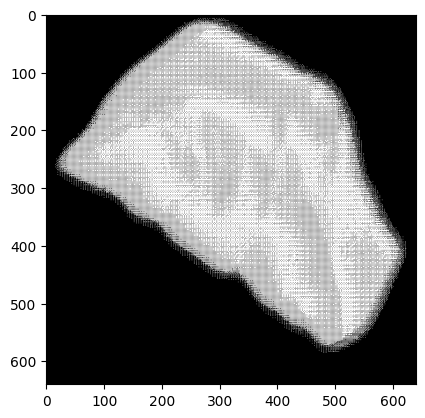

In [9]:
#make anyhting less than 1 0, otherwise 1
pred_trunc = np.where(pred_reshape < 1, 0, 1)

#display pred_trunc
plt.imshow(pred_trunc, cmap='gray')

Accuracy: 0.7431689453125
Precision: 0.3849853796366265
Recall: 0.8347081534669687
F1: 0.5269363600388531
Confusion Matrix: 
[[245813  93596]
 [ 11602  58589]]


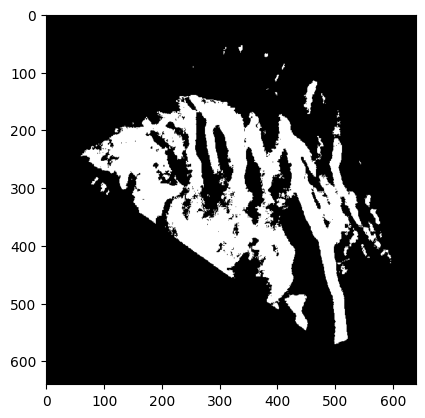

In [10]:
#load in mask
mask = cv2.imread(df['snowbinary_path'][1], cv2.IMREAD_GRAYSCALE)
plt.imshow(mask, cmap='gray')

#compare mask to pred
accuracy = accuracy_score(mask.flatten(), pred_trunc.flatten())
precision = precision_score(mask.flatten(), pred_trunc.flatten())
recall = recall_score(mask.flatten(), pred_trunc.flatten())
f1 = f1_score(mask.flatten(), pred_trunc.flatten())
conf_matrix = confusion_matrix(mask.flatten(), pred_trunc.flatten())

print(f'Accuracy: {accuracy}')
print(f'Precision: {precision}')
print(f'Recall: {recall}')
print(f'F1: {f1}')
print(f'Confusion Matrix: \n{conf_matrix}')

In [11]:
#try with round
round_accuracy = accuracy_score(mask.flatten(), pred_round.flatten())
round_precision = precision_score(mask.flatten(), pred_round.flatten())
round_recall = recall_score(mask.flatten(), pred_round.flatten())
round_f1 = f1_score(mask.flatten(), pred_round.flatten())
round_conf_matrix = confusion_matrix(mask.flatten(), pred_round.flatten())

print(f'Accuracy: {round_accuracy}')
print(f'Precision: {round_precision}')
print(f'Recall: {round_recall}')
print(f'F1: {round_f1}')
print(f'Confusion Matrix: \n{round_conf_matrix}')


#try with trunc
trunc_accuracy = accuracy_score(mask.flatten(), pred_trunc.flatten())
trunc_precision = precision_score(mask.flatten(), pred_trunc.flatten())
trunc_recall = recall_score(mask.flatten(), pred_trunc.flatten())
trunc_f1 = f1_score(mask.flatten(), pred_trunc.flatten())
trunc_conf_matrix = confusion_matrix(mask.flatten(), pred_trunc.flatten())

print(f'Accuracy: {trunc_accuracy}')
print(f'Precision: {trunc_precision}')
print(f'Recall: {trunc_recall}')
print(f'F1: {trunc_f1}')
print(f'Confusion Matrix: \n{trunc_conf_matrix}')


Accuracy: 0.69501220703125
Precision: 0.34673200784094094
Recall: 0.8820076648003305
F1: 0.49777881410784713
Confusion Matrix: 
[[222768 116641]
 [  8282  61909]]
Accuracy: 0.7431689453125
Precision: 0.3849853796366265
Recall: 0.8347081534669687
F1: 0.5269363600388531
Confusion Matrix: 
[[245813  93596]
 [ 11602  58589]]


In [14]:
model.layers[1].summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 640, 640,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 640, 640,  │        432 │ input_layer[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 640, 640,  │         64 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, 640, 640,  │          0 │ batch_normalizat… │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 640, 640,  │          0 │ activation[0][0]  │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 640, 640,  │      2,304 │ dropout[0][0]     │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 640, 640,  │         64 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, 640, 640,  │          0 │ batch_normalizat… │
│ (Activation)        │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 320, 320,  │          0 │ activation_1[0][… │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 320, 320,  │      4,608 │ max_pooling2d[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 320, 320,  │        128 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, 320, 320,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 320, 320,  │          0 │ activation_2[0][… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 320, 320,  │      9,216 │ dropout_1[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 320, 320,  │        128 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, 320, 320,  │          0 │ batch_normalizat… │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 160, 160,  │          0 │ activation_3[0][

 Total params: 31,128,241 (118.74 MB)

 Trainable params: 31,116,081 (118.70 MB)

 Non-trainable params: 12,160 (47.50 KB)

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 709ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 893ms/step


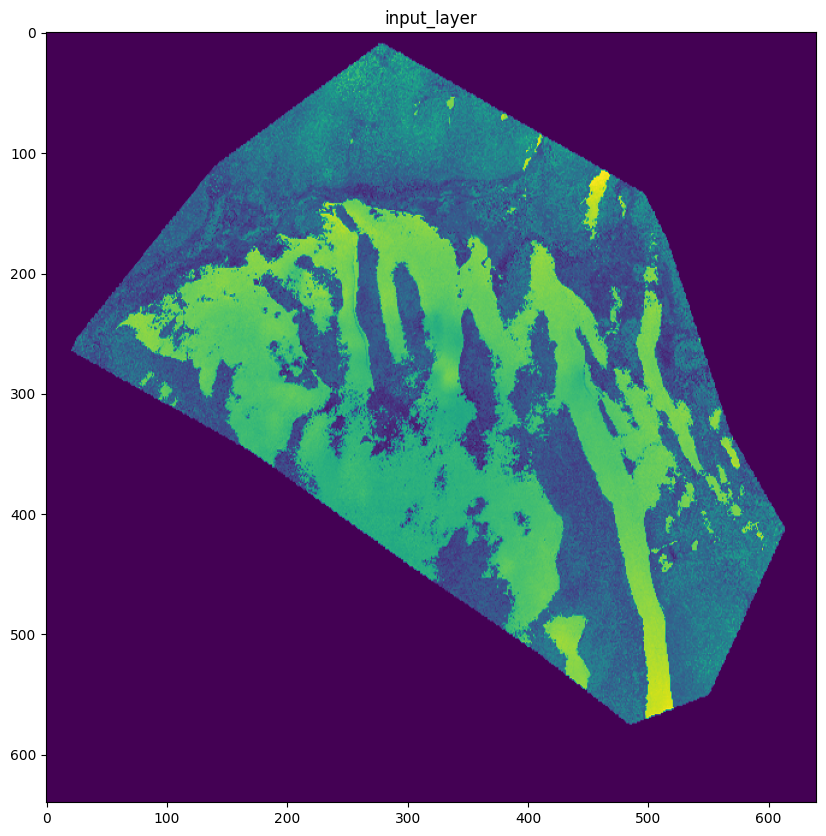

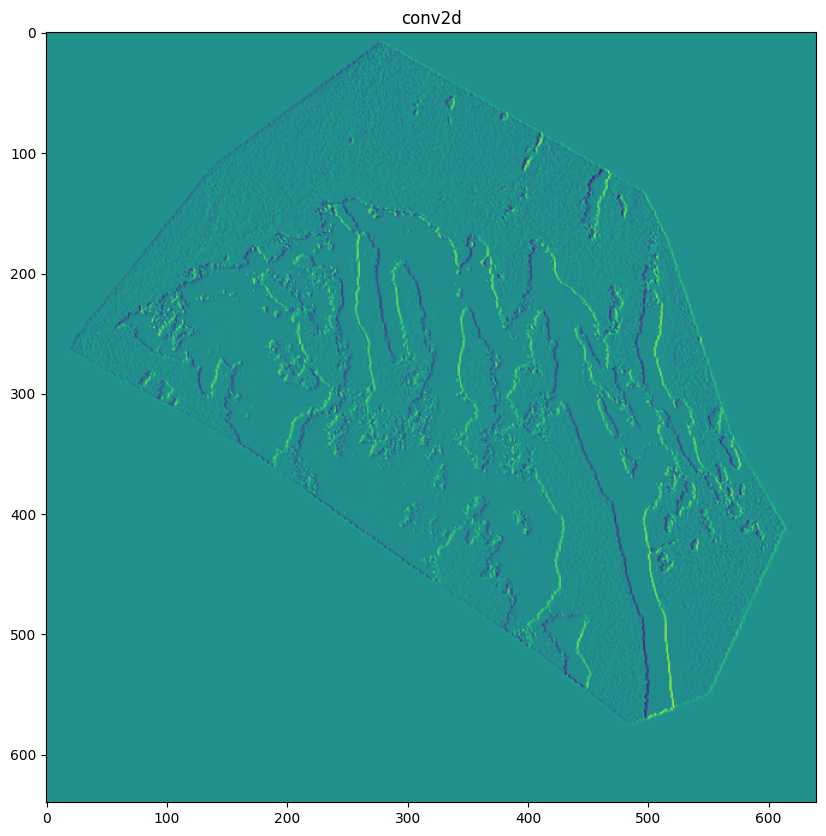

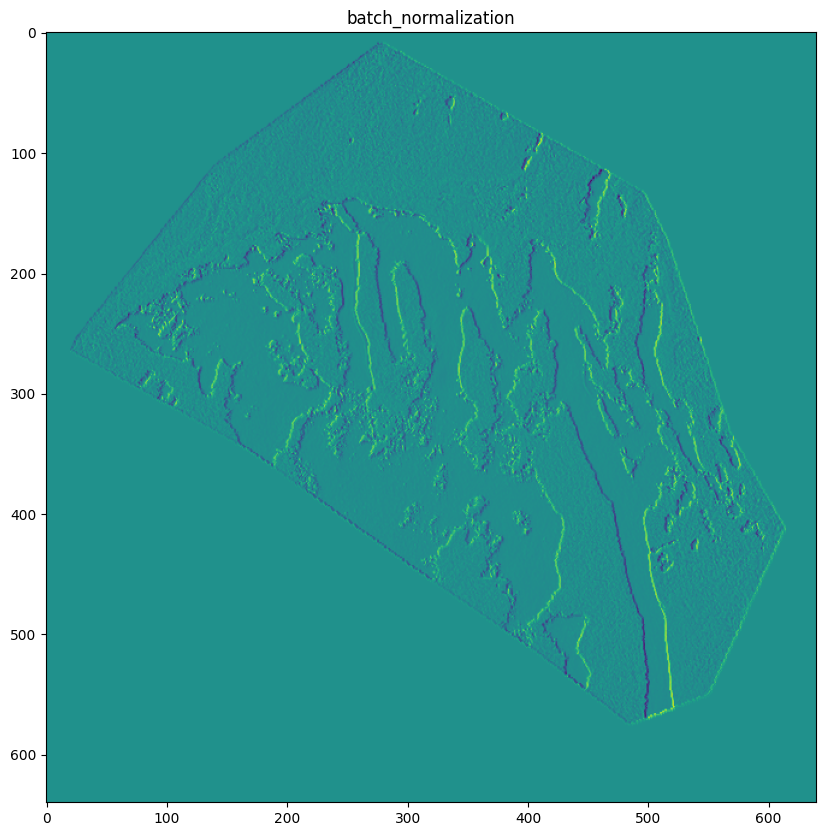

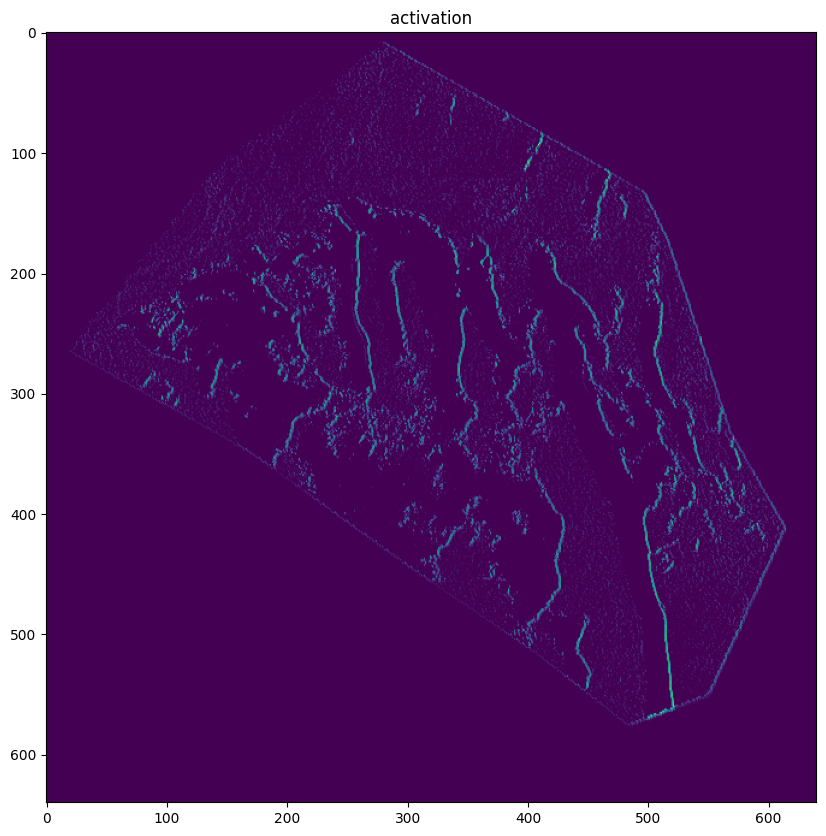

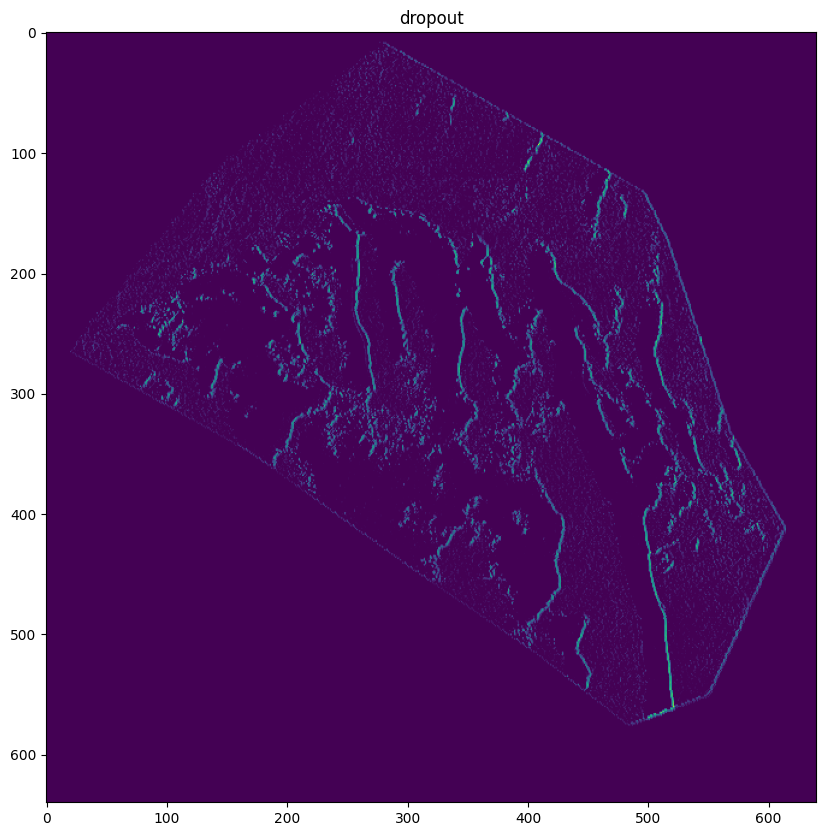

...

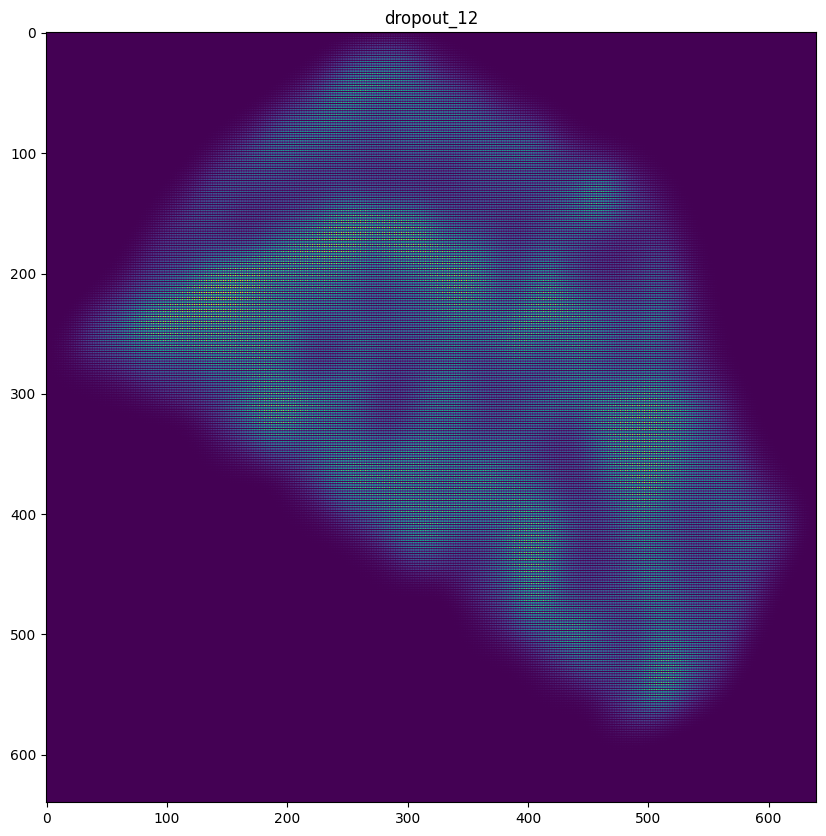

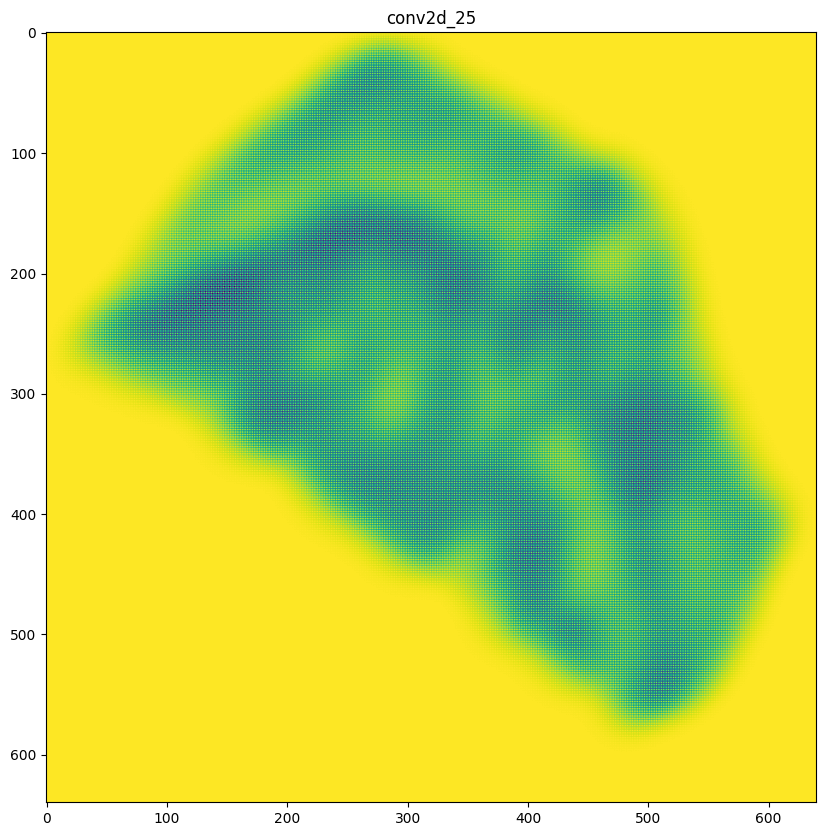

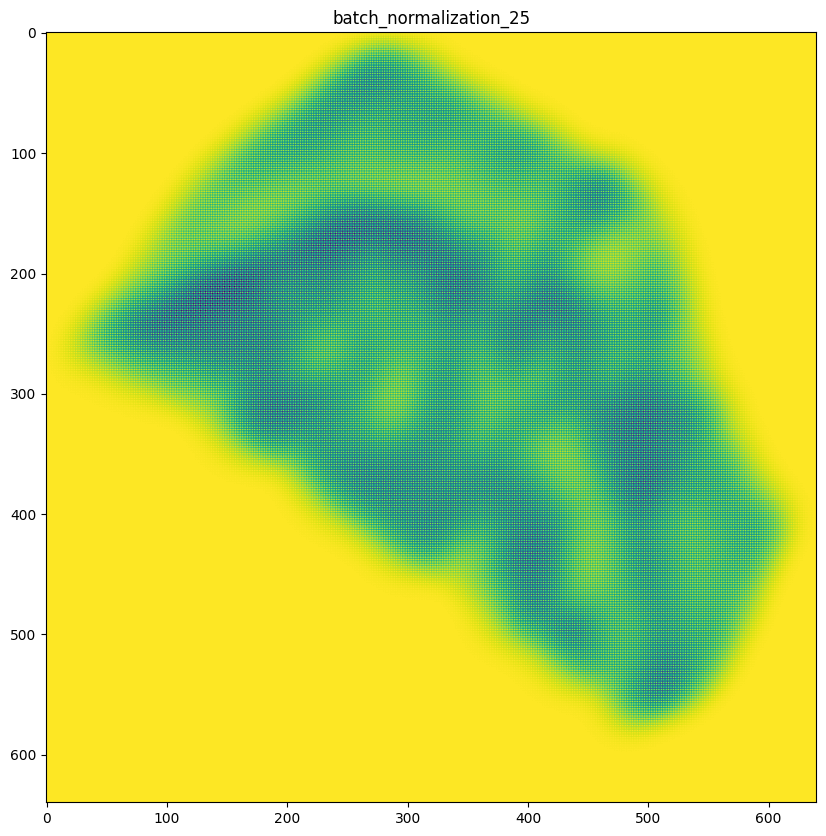

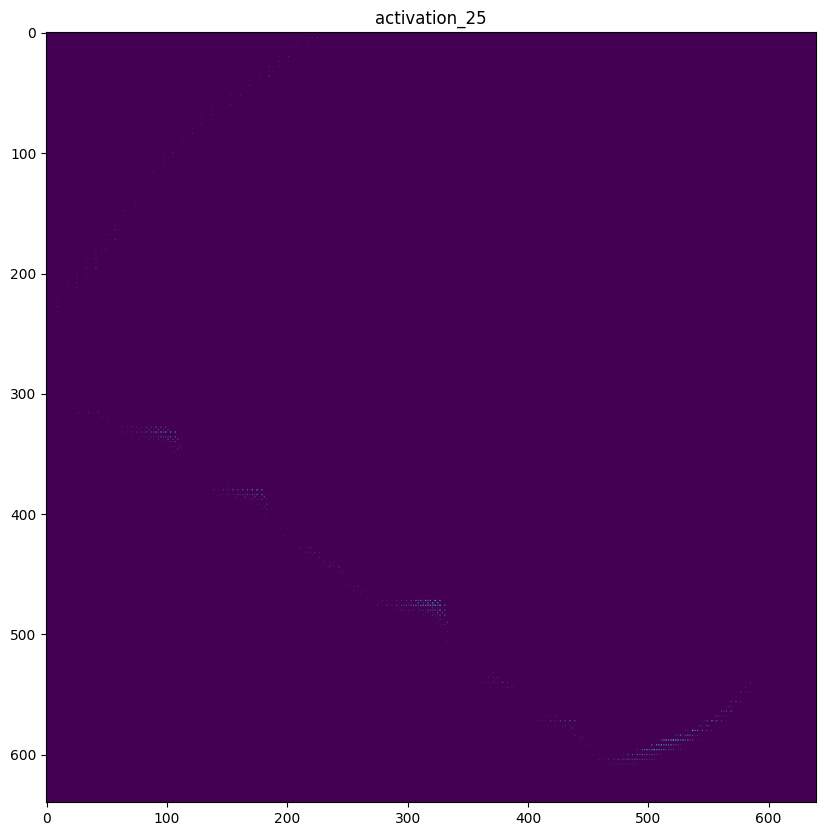

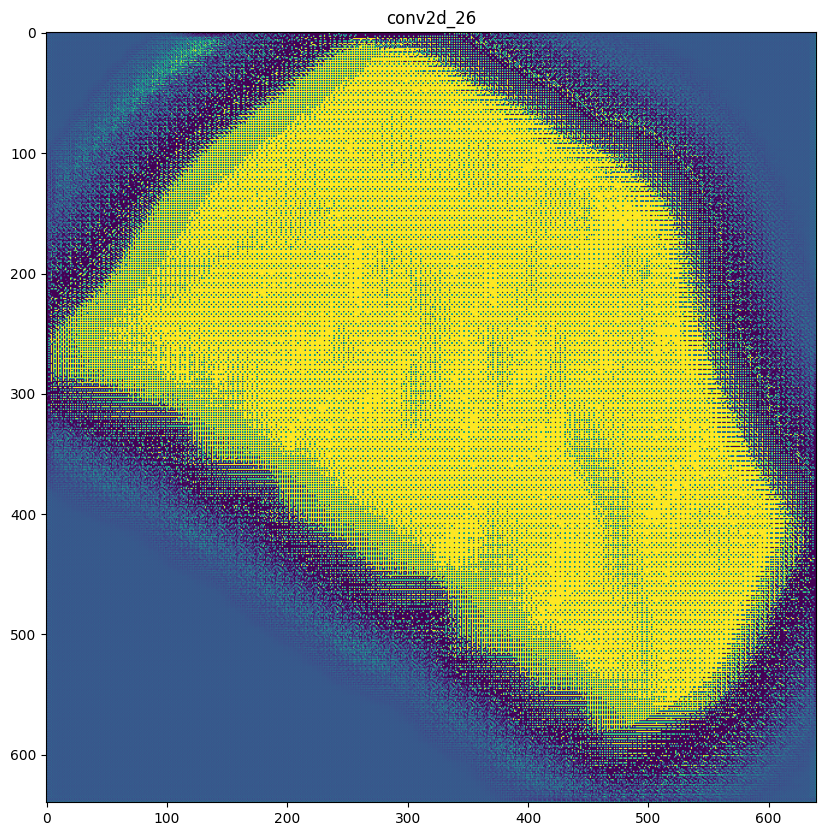

In [15]:
input_shape = (1, 640, 640, 3)  # Adjust if necessary to match your model input shape
sample_input = np.random.random(input_shape).astype(np.float32)
_ = model.predict(sample_input)

layer_outputs = [layer.output for layer in model.layers[1].layers]
activation_model = tf.keras.models.Model(inputs=model.layers[1].input, outputs=layer_outputs)

activations = activation_model.predict(img)

layer_names = [layer.name for layer in model.layers[1].layers]
for layer_name, activation in zip(layer_names, activations):
    if len(activation.shape) == 4:  # conv layer
        plt.figure(figsize=(10, 10))
        plt.imshow(activation[0, :, :, 0], cmap='viridis')
        plt.title(layer_name)
        plt.show()